In [1]:
using Markdown

In [2]:
using LaTeXStrings, DifferentialEquations, LinearAlgebra, Plots, SparseArrays

In [3]:
using ForwardDiff

# Self Activating Toggle Switch

_Add required function to implement model_

In [4]:
begin
	mma(x) = 1/(1+x)
	mmr(x) = 1/(1+1/x)
	hfr(n) = x -> 1/(1 + x^n)
	hfa(n) = x -> 1/(1 + (1/x)^n)
	hs(λ, n) = x-> hfr(n)(x) + λ * hfa(n)(x)
	hs(λ, n, x₀) = x-> hs(λ, n)(x/x₀)
end

hs (generic function with 2 methods)

_Implement model piecewise (separate production and degradation terms) for simulations and computation_

In [5]:
begin
	n = 4 # hill coefficient
	λ₁ = 3 # for bistable
	λ₂ = 10 # for tristable
	λₙ = 0.1 # repressor
	x₁ = 80 # cutoff count bistable
	x₂ = 25 # cutoff count tristable
	xₙ = 20 # cuttoff count repress
	p = 5 # unregulated production rate
	d = 0.1 # death rate
	proda(a,b) = p*hs(λ₂, n, x₂)(a)*hs(λₙ, n, xₙ)(b)
	dega(a, b) = d*a
	dadt(a, b) = proda(a, b) - dega(a, b) 
	prodb(a, b) = proda(b, a)
	degb(a, b)= d*b
	dbdt(a, b) = prodb(a,b) - degb(a, b)
	dfx = dadt
	dfy = dbdt
end

dbdt (generic function with 1 method)

In [6]:
begin
	fx(x::Vector) = dfx(x[1], x[2])
    fy(x::Vector) = dfy(x[1], x[2])
    f(x::Vector) = [fx(x), fy(x)]
end

f (generic function with 1 method)

_Run Helmholtz decomposition using ForwardDiff for the divergence_

In [7]:
begin
	# savefig(p_pot, "ch4_comp_pot.pdf")
	# savefig(p_rhs, "ch4_comp_rhs.pdf")
end

_Compute Vector Field_

In [8]:
begin
	n_min = 0
	n_max = 550
end

550

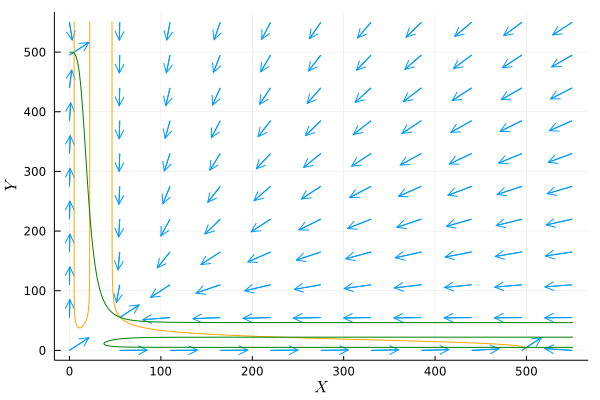

In [9]:
begin
	dq = (n_max - n_min) / 10.
	xs = n_min:dq:n_max+1
	ys = n_min:dq:n_max+1
	
	dxs = n_min:.5:n_max+1
	dys = n_min:.5:n_max+1

	df(x, y) = normalize([dfx(x, y), dfy(x,y)]) .* 30

	xxs = [x for x in xs for y in ys]
	yys = [y for x in xs for y in ys]

	quiver(xxs, yys, quiver=df)
	contour!(dxs, dys, dfx, levels=[0], color=:orange, label="X Nullcline", colorbar = false)
	contour!(dxs, dys, dfy, levels=[0], color=:green, label = "Y Nullcline", colorbar = false, xlabel=L"X", ylabel=L"Y", legend=:topright,)
end

In [10]:
begin
	random_count() = floor(Int, n_min + rand() * (n_max - n_min))
	rand_u0() = [random_count(), random_count()]
	u0 = rand_u0()
	u0 = [5, 500]
	t = (0.0, 30000.0)
end

(0.0, 30000.0)

_Stochastic DiffEq of Langevin equation for this system_

In [11]:
begin
	function f(du, u, p, t)
		du[1] = dfx(u...)
		du[2] = dfy(u...)
		du[1], du[2]
	end

	g(du, u, p, t) = begin
	  du[1,1] = sqrt(abs(proda(u[1], u[2])))
	  du[1,2] = -sqrt(abs(degb(u[1], u[2])))
	  du[1,3] = 0
	  du[1,4] = 0
	  du[2,1] = 0
	  du[2,2] = 0
	  du[2,3] = sqrt(abs(prodb(u[1], u[2])))
	  du[2,4] = -sqrt(abs(degb(u[1], u[2])))
	end
end

g (generic function with 1 method)

In [12]:
begin
	
	minval = 1
	maxval =  505
	nsample = 256
	rhs_xs = range(minval, maxval, length=nsample)
	rhs_ys = range(minval, maxval, length=nsample)

	divergence(F::Function, pt) = sum(
    	diag(
        	ForwardDiff.jacobian(F, pt)
        	)
    	)

	rhs_new = [divergence(f, [x, y]) for x=rhs_xs, y=rhs_ys]
end

256×256 Matrix{Float64}:
 -0.199078  -0.187393   -0.143724    -0.048019    …  -0.199952    -0.199952
 -0.187393  -0.175718   -0.132103    -0.0365489      -0.198783    -0.198783
 -0.143724  -0.132103   -0.0887429    0.00611913     -0.194416    -0.194416
 -0.048019  -0.0365489   0.00611913   0.0991794      -0.184845    -0.184845
  0.115702   0.126852    0.168112     0.257596       -0.168471    -0.168471
  0.353829   0.364426    0.403307     0.486866    …  -0.144656    -0.144656
  0.656163   0.66594     0.701367     0.776451       -0.114419    -0.11442
  0.991237   0.99996     1.03101      1.09549        -0.0809077   -0.0809078
  1.30949    1.31701     1.34317      1.39599        -0.0490778   -0.0490779
  1.55691    1.56323     1.58454      1.62601        -0.0243302   -0.0243303
  1.69413    1.69934     1.71634      1.74792     …  -0.0106041   -0.0106042
  1.70966    1.71394     1.72742      1.75126        -0.00904762  -0.00904771
  1.61978    1.62331     1.63414      1.65243        -0.01

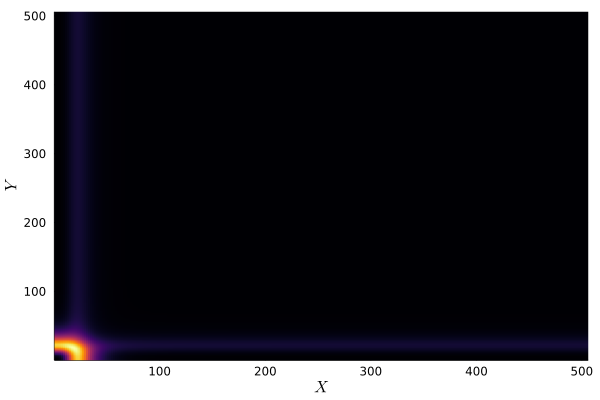

In [13]:
begin
	p_rhs = heatmap(rhs_xs, rhs_ys, rhs_new, xlabel=L"X", ylabel=L"Y", colorbar=:none)
end

In [14]:
begin
	sde_prob_ssa= SDEProblem(f, g, u0, t, noise_rate_prototype=zeros(2,4))
	sde_sol = solve(sde_prob_ssa)
end

┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345


retcode: DtLessThanMin
Interpolation: 1st order linear
t: 86999-element Vector{Float64}:
     0.0
     2.910508956835909e-7
     6.184831533276307e-7
     9.868444431771756e-7
     1.4012508942579135e-6
     1.8674581517237437e-6
     2.3919413163728028e-6
     2.981984876602994e-6
     3.6457838818619595e-6
     4.392557762778295e-6
     5.232678378809173e-6
     6.177814071843911e-6
     7.241091726507992e-6
     ⋮
 23542.178575796537
 23542.360200730658
 23542.564528781546
 23542.794397838796
 23543.0530005282
 23543.32353513031
 23543.62385721609
 23543.941567437698
 23544.298991437005
 23544.701093436222
 23545.036843327278
 23545.12194082928
u: 86999-element Vector{Vector{Float64}}:
 [5.0, 500.0]
 [4.998445499790408, 499.99895879479806]
 [4.997974996095271, 500.00155249337115]
 [4.993974986150907, 499.9925236185461]
 [4.99456314914844, 499.98940826985404]
 [4.987631615670938, 499.98308519113345]
 [4.979020646960344, 499.988146432747]
 [4.979027603686411, 499.9933952524822]
 [4.98

In [15]:
sde_plot = plot(sde_sol, vars=[(1, 2)], xlabel=L"X", ylabel=L"Y",legend=:none)
savefig(sde_plot, "SATS_sde_plot.pdf")

_Gillespie Jump Process formulation for the same problem_

In [16]:
begin
	proda!(integrator) = integrator.u[1] += 1
	prodb!(integrator) = integrator.u[2] += 1
	dega!(integrator) = integrator.u[1] -= 1
	degb!(integrator) = integrator.u[2] -= 1
	jumps = Dict(proda => proda!, prodb => prodb!, dega => dega!, degb => degb!)
	constJumps = []
	for (rate, jump) in jumps
		push!(constJumps, ConstantRateJump((u, p, t) -> rate(u...), jump))
	end
	constJumps
end

4-element Vector{Any}:
 ConstantRateJump{var"#17#18"{typeof(proda)}, typeof(proda!)}(var"#17#18"{typeof(proda)}(proda), proda!)
 ConstantRateJump{var"#17#18"{typeof(prodb)}, typeof(prodb!)}(var"#17#18"{typeof(prodb)}(prodb), prodb!)
 ConstantRateJump{var"#17#18"{typeof(degb)}, typeof(degb!)}(var"#17#18"{typeof(degb)}(degb), degb!)
 ConstantRateJump{var"#17#18"{typeof(dega)}, typeof(dega!)}(var"#17#18"{typeof(dega)}(dega), dega!)

In [17]:
begin
	dprob_ssa = DiscreteProblem(u0, t)
	jprob_ssa = JumpProblem(dprob_ssa, Direct(), constJumps...)
end


Number of constant rate jumps: 4
Number of variable rate jumps: 0


In [18]:
ssa_sol = solve(jprob_ssa, SSAStepper())

retcode: Default
Interpolation: Piecewise constant interpolation
t: 2988833-element Vector{Float64}:
     0.0
     0.024071853846978065
     0.0327441707559156
     0.04583388690915828
     0.053568418325886526
     0.05794376413794675
     0.06908809325132233
     0.06921299584568397
     0.0960160332234628
     0.11683317974055703
     0.11790643564601012
     0.12368853279393327
     0.1275023979197143
     ⋮
 29999.808281144095
 29999.809659479415
 29999.81150217346
 29999.836692508652
 29999.84321426462
 29999.85148324632
 29999.866360965807
 29999.889562441207
 29999.933240361588
 29999.986323294124
 29999.997285986006
 30000.0
u: 2988833-element Vector{Vector{Int64}}:
 [5, 500]
 [5, 501]
 [5, 500]
 [5, 499]
 [5, 498]
 [5, 499]
 [5, 498]
 [5, 499]
 [5, 500]
 [5, 501]
 [5, 500]
 [5, 501]
 [5, 502]
 ⋮
 [6, 488]
 [6, 489]
 [6, 488]
 [6, 487]
 [6, 488]
 [6, 489]
 [6, 490]
 [6, 489]
 [6, 488]
 [6, 487]
 [6, 486]
 [6, 486]

In [19]:
stoch_tri = plot(ssa_sol, labels=[L"X" L"Y"], xlabel=L"t", legend=(0.9, 0.5))

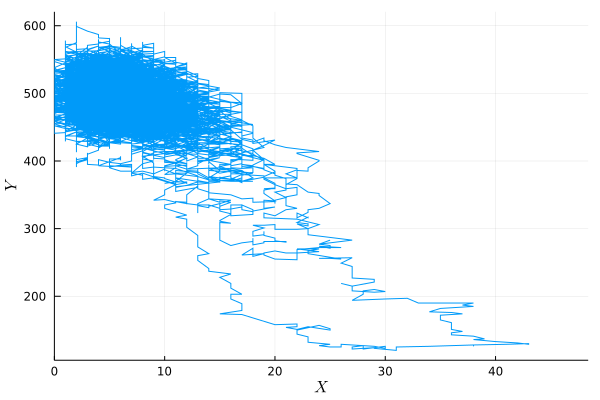

In [20]:
stoch_tri3 = plot(ssa_sol, vars=[(1, 2)], xlabel=L"X", ylabel=L"Y",legend=:none)

In [21]:
pstoch = plot(stoch_tri, stoch_tri3, layout=(1, 2), size=(900, 500), title = ["A" "B"], titlelocation = :left)

In [22]:
# savefig(pstoch, "ch4_tri_stoch.pdf")

_Setup helper functions for running longer simulations_

In [23]:
function get_u0(i)
	offset = 1.0
	new_u0 = [0.0, 0.0]
	if i % 3 == 0
		new_u0 = [55, 55]
	elseif i % 3 == 1
		new_u0 .+= [5, 500]
	elseif i % 3 == 2
		new_u0 .+= [500, 5]
	end
	new_u0
end

get_u0 (generic function with 1 method)

In [24]:
# savefig(ps, "ch4_ad_hoc.pdf")

_Helper function to generate -∇ ² to solve the Helmhotz equation_

In [25]:
begin
	eye(N, M) = sparse(I, N, M)
	eye(M) = eye(M, M)
	diff1(M) = [ [1.0 zeros(1, M - 1)]; diagm(1 => ones(M - 1)) - eye(M) ]
	sdiff1(M) = sparse(diff1(M))

	# make the discrete -Laplacian in 2d, with Dirichlet boundaries
	function laplacian2d(Nx, Ny, Lx, Ly)
		dx = Lx / (Nx + 1)
		dy = Ly / (Ny + 1)
		Dx = sdiff1(Nx) / dx
		Dy = sdiff1(Ny) / dy
		Ax = Dx' * Dx
		Ay = Dy' * Dy
		return Dx, Dy, kron(eye(Ny), Ax) + kron(Ay, eye(Nx))
	end	
end

laplacian2d (generic function with 1 method)

In [26]:
begin
	_, _, Δ = laplacian2d(nsample, nsample, maxval - minval, maxval - minval)
	sol = reshape(Δ \ reshape(rhs_new, length(rhs_new)),  size(rhs_new)...)
end

256×256 Matrix{Float64}:
   2.43212    5.24705    8.33599  …   -5.38033   -3.85295   -2.11273
   5.24705   10.9408    16.9724      -10.1287    -7.14974   -3.829
   8.33599   16.9724    25.8132      -14.3517   -10.0239    -5.28902
  11.6773    23.3077    34.8246      -18.1302   -12.5573    -6.55551
  15.25      29.897     43.9402      -21.5325   -14.8086    -7.66486
  18.9807    36.6024    52.9804   …  -24.6278   -16.8317    -8.64743
  22.7098    43.1499    61.6013      -27.4953   -18.6869    -9.5368
  26.1849    49.125     69.2949      -30.2262   -20.4437   -10.3728
  29.0928    54.0244    75.4539      -32.9186   -22.1777   -11.1996
  31.1257    57.3611    79.4972      -35.6641   -23.9601   -12.0593
  32.0611    58.7851    81.0125   …  -38.534    -25.8457   -12.9839
  31.8182    58.1704    79.8576      -41.5677   -27.8638   -13.99
  30.4662    55.6291    76.1784      -44.7712   -30.0171   -15.0775
   ⋮                              ⋱                          ⋮
 -15.732    -30.7192   -44

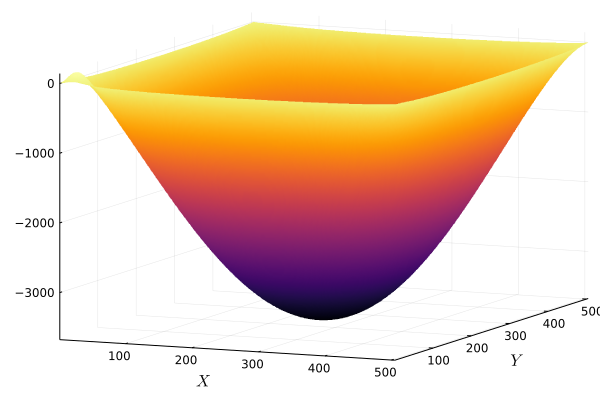

In [27]:
p_pot = surface(rhs_xs, rhs_ys, sol, xlabel=L"X", ylabel=L"Y", colorbar=:none)

_Helper function to compute 2D histograms for Probability distributions_

In [28]:
begin
	nbins = 701
	bin_min = 0
	bin_max = 700
	xbins = range(bin_min, bin_max, length=nbins)
	ybins = range(bin_min, bin_max, length=nbins)

	function bucket_idx(val, vec)
		idx = 1
		while val > vec[idx]
			idx += 1
		end
		idx
	end
	
	function althist(x, y, dt, xedges, yedges) 
	   counts = spzeros(length(yedges)-1, length(xedges)-1)
		for i=1:length(x) - 1
			r = bucket_idx(y[i], yedges)
			c = bucket_idx(x[i], xedges)
			counts[r,c] += dt[i]
		end
 		counts
	end
end

althist (generic function with 1 method)

_Storage for unnormalized probabilities that sum up the `dt`s in each bin_

In [29]:
begin
	unnorm_ssa = spzeros(length(xbins)-1, length(ybins)-1)
	unnorm_sde = spzeros(length(xbins)-1, length(ybins)-1)
	tspan = (0., 5e4)
end

(0.0, 50000.0)

_Rerun the following cell to add more values to the SSA simulation_

In [30]:
begin
	global n_points_sim
	for i in 1:3*10
		long_jprob_ssa = JumpProblem(
			DiscreteProblem(get_u0(i), tspan), Direct(), constJumps...)
		long_ssa_sol = solve(long_jprob_ssa, SSAStepper())
		unnorm_ssa .+= althist(long_ssa_sol[1,:], long_ssa_sol[2, :], diff(long_ssa_sol.t[:]), xbins, ybins)
	end
	unnorm_ssa
end

700×700 SparseMatrixCSC{Float64, Int64} with 31740 stored entries:
⠀⠀⠀⣀⣠⣤⣤⣤⣤⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣾⣿⣿⣿⣿⡿⠿⡿⠿⠿⠿⠛⠛⠃⠀⠀⠀⠀⠀
⠀⢀⣾⣿⣿⣿⡿⠿⠿⠿⠿⠛⠛⠛⠛⠛⠛⠉⠉⠉⠉⠉⠉⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⣿⣿⣿⠟⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢰⣿⣿⣯⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⣧⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⠟⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠆⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡏⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⡟⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀

_Rerun the following cell to have the SDE simulation catch up to the SSA_

In [31]:
begin
	i = 1
	num_sde_run_failures = 0
	while sum(unnorm_sde) < sum(unnorm_ssa)
		global i
		global num_sde_run_failures

		
		sde_run = SDEProblem(f, g, get_u0(i), tspan, noise_rate_prototype=zeros(2,4))
		sol = solve(sde_prob_ssa)
	
		if sol.t[end] < tspan[end]
			# the simulation did not complete succesfully.
			# This is a sign of divergence and a failing approximation
			num_sde_run_failures += 1
		end
		unnorm_sde .+= althist(sol[1,:], sol[2, :], diff(sol.t[:]), xbins, ybins)
		i += 1
	end
	unnorm_sde, num_sde_run_failures, i
end

┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/package

┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/packages/SciMLBase/EFFG1/src/integrator_interface.jl:345
┌ Warning: dt <= dtmin. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase /Users/bsm/.julia/package

(
⠀⠀⠀⣀⣤⣤⣤⣤⣴⣶⣶⣶⣶⣶⣶⣶⣶⣶⣾⣾⣿⣿⣿⣿⣿⣿⣿⠿⠿⠿⠿⠿⠛⠀⠀⠀⠀⠀⠀⠀
⠀⢠⣿⣿⣿⣿⡿⡿⡿⠛⠛⠛⠛⠋⠛⠛⠋⠉⠙⠉⠉⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⣿⣿⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣾⣿⣿⣿⡯⡀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⡷⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⡗⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⣇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠥⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⡏⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⡯⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⡿⠃⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀, 93, 94)

In [32]:
prob_ssa = unnorm_ssa ./ sum(unnorm_ssa)

700×700 SparseMatrixCSC{Float64, Int64} with 31740 stored entries:
⠀⠀⠀⣀⣠⣤⣤⣤⣤⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣶⣾⣿⣿⣿⣿⡿⠿⡿⠿⠿⠿⠛⠛⠃⠀⠀⠀⠀⠀
⠀⢀⣾⣿⣿⣿⡿⠿⠿⠿⠿⠛⠛⠛⠛⠛⠛⠉⠉⠉⠉⠉⠉⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⣿⣿⣿⠟⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢰⣿⣿⣯⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⣧⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⠟⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⢸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣸⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠆⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡏⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⡇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⡟⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀

In [39]:
prob_sde = unnorm_sde ./ sum(unnorm_sde)

700×700 SparseMatrixCSC{Float64, Int64} with 33705 stored entries:
⠀⠀⠀⣀⣤⣤⣤⣤⣴⣶⣶⣶⣶⣶⣶⣶⣶⣶⣾⣾⣿⣿⣿⣿⣿⣿⣿⠿⠿⠿⠿⠿⠛⠀⠀⠀⠀⠀⠀⠀
⠀⢠⣿⣿⣿⣿⡿⡿⡿⠛⠛⠛⠛⠋⠛⠛⠋⠉⠙⠉⠉⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⣿⣿⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣾⣿⣿⣿⡯⡀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⡷⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⡗⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⣇⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠥⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⣿⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⡏⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⡯⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⣿⣿⠁⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⡿⠃⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀
⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀

_the SDE probability distribution is complete non-sense_

In [40]:
begin
	plotly()
	pl = surface(prob_sde, xlabel="X", ylabel="Y")
	gr()
	pl
end

<!DOCTYPE html>
 
 
 Plots.jl

In [35]:
begin
	xplot = range(bin_min, bin_max, length=nbins-1)
	yplot = range(bin_min, bin_max, length=nbins-1)
end

0.0:1.0014306151645207:700.0

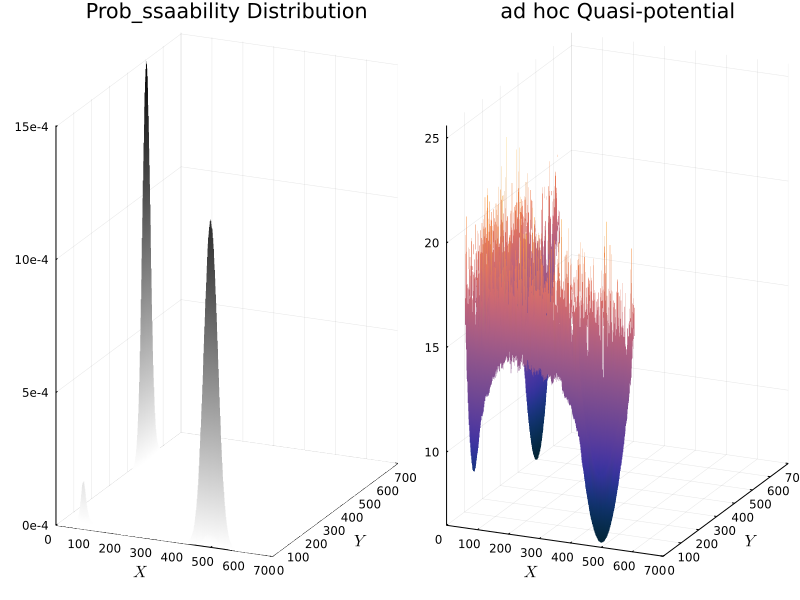

In [37]:
 begin
	pp1 = surface(xplot, yplot,-log.(prob_ssa), c = :thermal, title="ad hoc Quasi-potential")
	pp2 =  surface(xplot, yplot, prob_ssa, c = :grayC, title="Prob_ssaability Distribution", zaxis=(formatter=y->string(round(Int, y / 10^-4))*"e-4" ) )
	ps = plot(pp2, pp1, layout =(1, 2), size=(800, 600), xlabel=L"X", ylabel=L"Y", colorbar=:none)
end